In [1]:
from PIL import Image, ImageFilter, ImageChops, ImageStat
import numpy as np
import matplotlib.pyplot as plt

image_path = "my_image.png"
original_image = Image.open(image_path).convert("RGB")

# Zadanie 1

Image mode: RGB
Image size: (1000, 848)


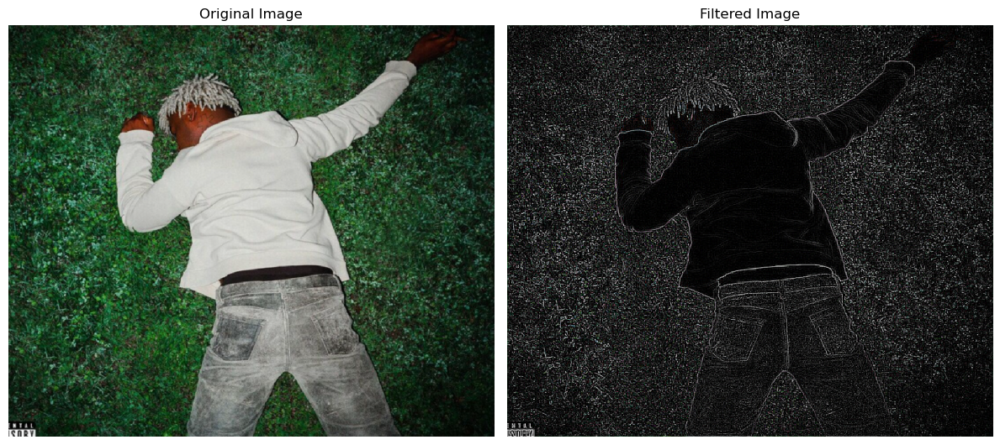

In [2]:
def filtruj(image, kernel, scale=1):

    size = int(len(kernel) ** 0.5)
    if size * size != len(kernel):
        raise ValueError("Kernel must be a square matrix (e.g., 3x3, 5x5).")
    
    kernel = [val / scale for val in kernel]
    return image.filter(ImageFilter.Kernel((size, size), kernel, scale=1, offset=0))

image_path = "my_image.png"
image = Image.open(image_path).convert('RGB')

print(f"Image mode: {image.mode}")
print(f"Image size: {image.size}")

kernel_example = [-1, -1, -1, -1, 8, -1, -1, -1, -1]
scale_factor = 1

filtered_image = filtruj(image, kernel_example, scale_factor)

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.title("Original Image")
plt.imshow(image)
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title("Filtered Image")
plt.imshow(filtered_image)
plt.axis('off')

plt.tight_layout()
plt.show()

# Zadanie 2

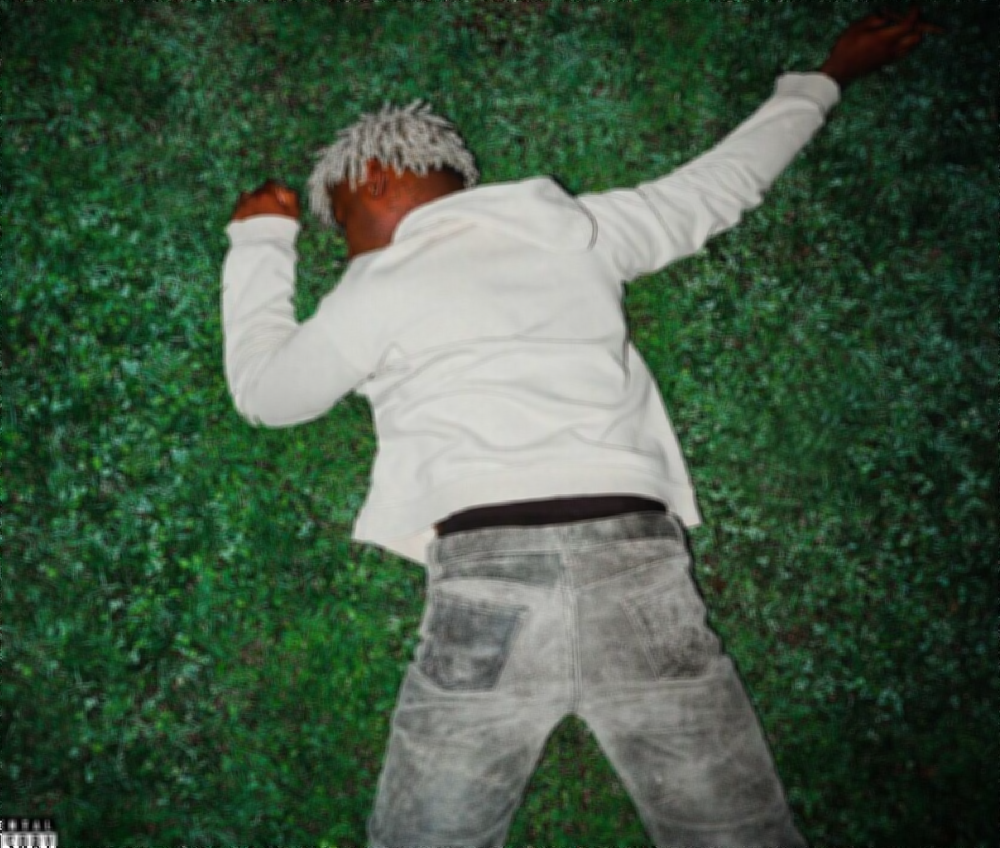

In [3]:
zad2_a_image = original_image.filter(ImageFilter.BLUR )
zad2_a_image.save("zad2_a_image.jpg")
zad2_a_image

In [4]:
filter_params = ImageFilter.BLUR.filterargs
filter_params

((5, 5),
 16,
 0,
 (1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1))

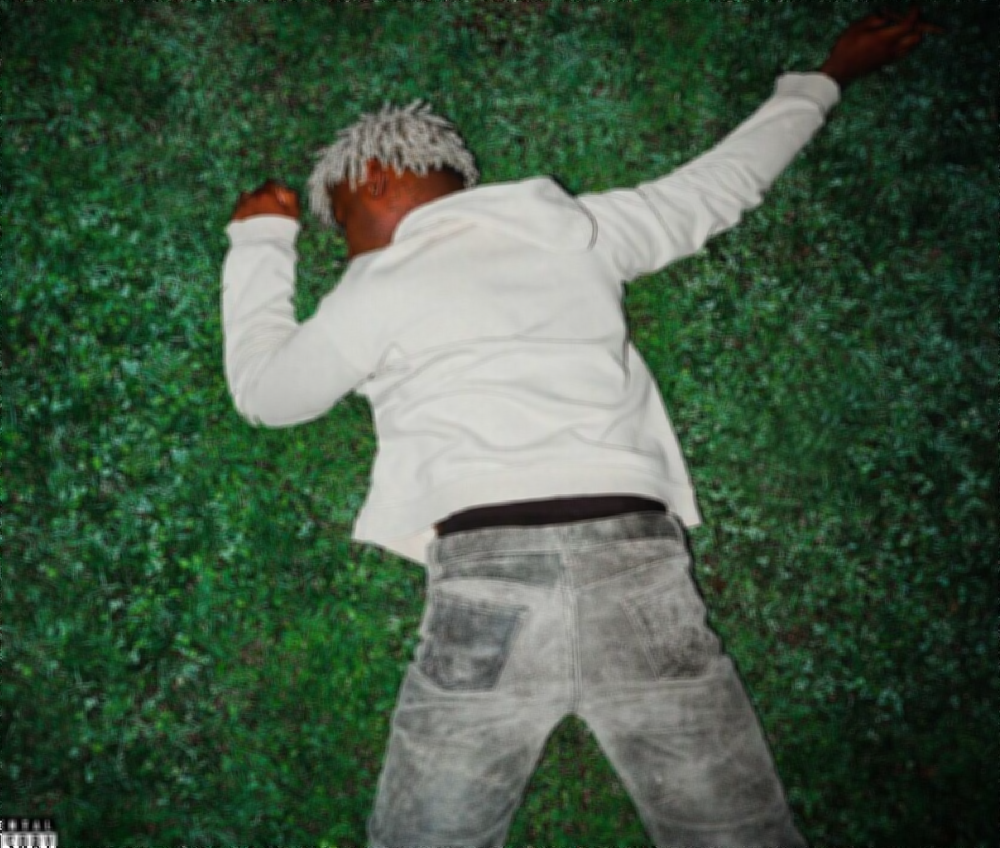

In [5]:
filter_params = ImageFilter.BLUR.filterargs

filter_params = ImageFilter.BLUR.filterargs
kernel_size = filter_params[0][0]  # Rozmiar jądra (np. 5 dla macierzy 5x5)
scale = filter_params[1]
kernel = filter_params[3]          

zad2_b_image = filtruj(original_image, kernel, scale)
zad2_b_image.save("zad2_b_image.jpg")
zad2_b_image

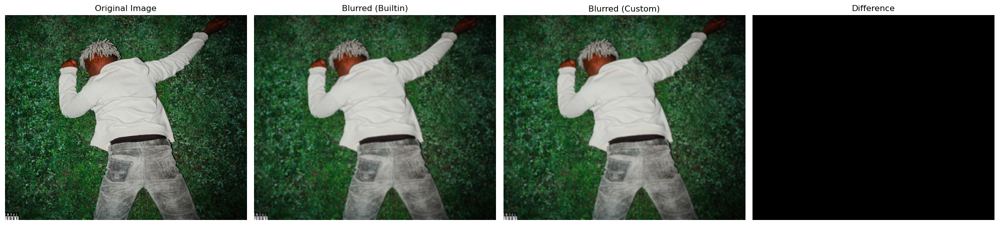

In [6]:
zad2_a_image
zad2_b_image
difference_image = ImageChops.difference(zad2_a_image, zad2_b_image)

fig, axes = plt.subplots(1, 4, figsize=(20, 5))
axes[0].imshow(original_image)
axes[0].set_title("Original Image")
axes[0].axis("off")

axes[1].imshow(zad2_a_image)
axes[1].set_title("Blurred (Builtin)")
axes[1].axis("off")

axes[2].imshow(zad2_b_image)
axes[2].set_title("Blurred (Custom)")
axes[2].axis("off")

axes[3].imshow(difference_image)
axes[3].set_title("Difference")
axes[3].axis("off")

plt.tight_layout()
plt.savefig("fig1.png")
plt.show()

# Zadanie 3

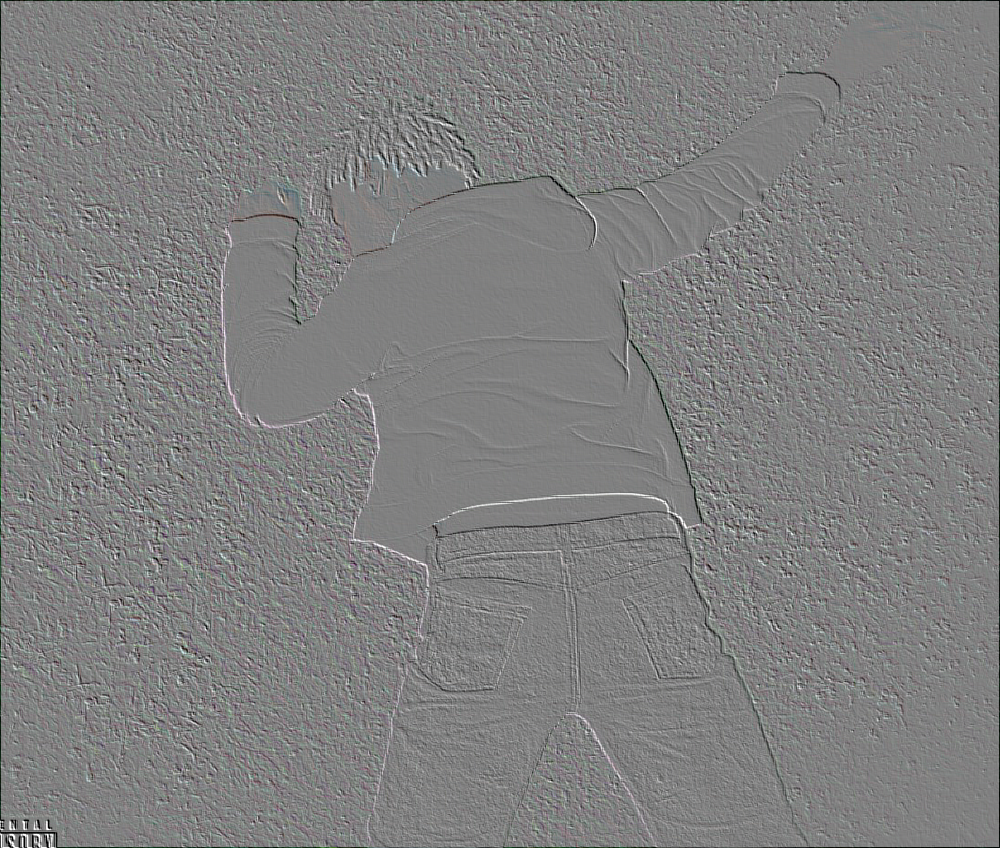

In [7]:
image_L_mode = original_image.convert('L') 
zad3_a_image = original_image.filter(ImageFilter.EMBOSS )
zad3_a_image.save("zad3_a_image.jpg")
zad3_a_image

## i. SOBEL1: (-1, 0, 1, -2, 0, 2, -1, 0, 1). Zastosuj filtr  

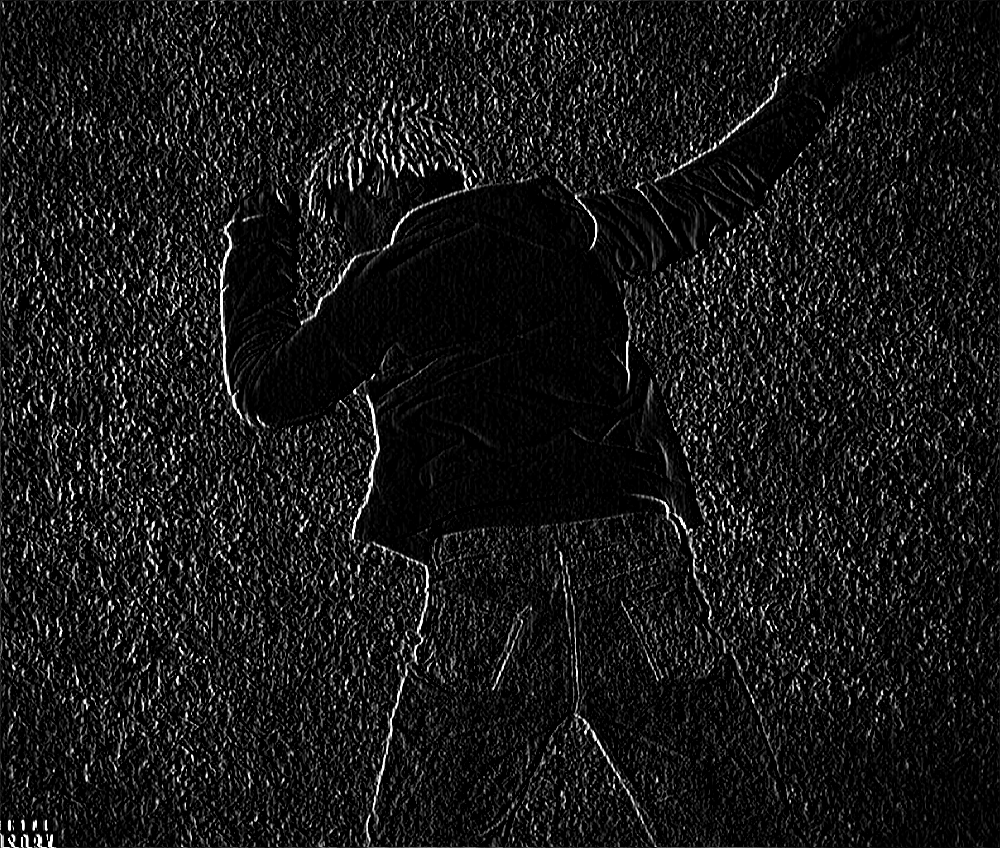

In [8]:
ImageFilter.EMBOSS.filterargs = ((3, 3), 1, 0, (-1, 0, 1, -2, 0, 2, -1, 0, 1)) # zmiana argumentów
zad3_a_1_image = image_L_mode.filter(ImageFilter.EMBOSS)
zad3_a_1_image

## ii. SOBEL2: (-1, -2, -1, 0, 0, 0, 1, 2, 1). Zastosuj filtr 

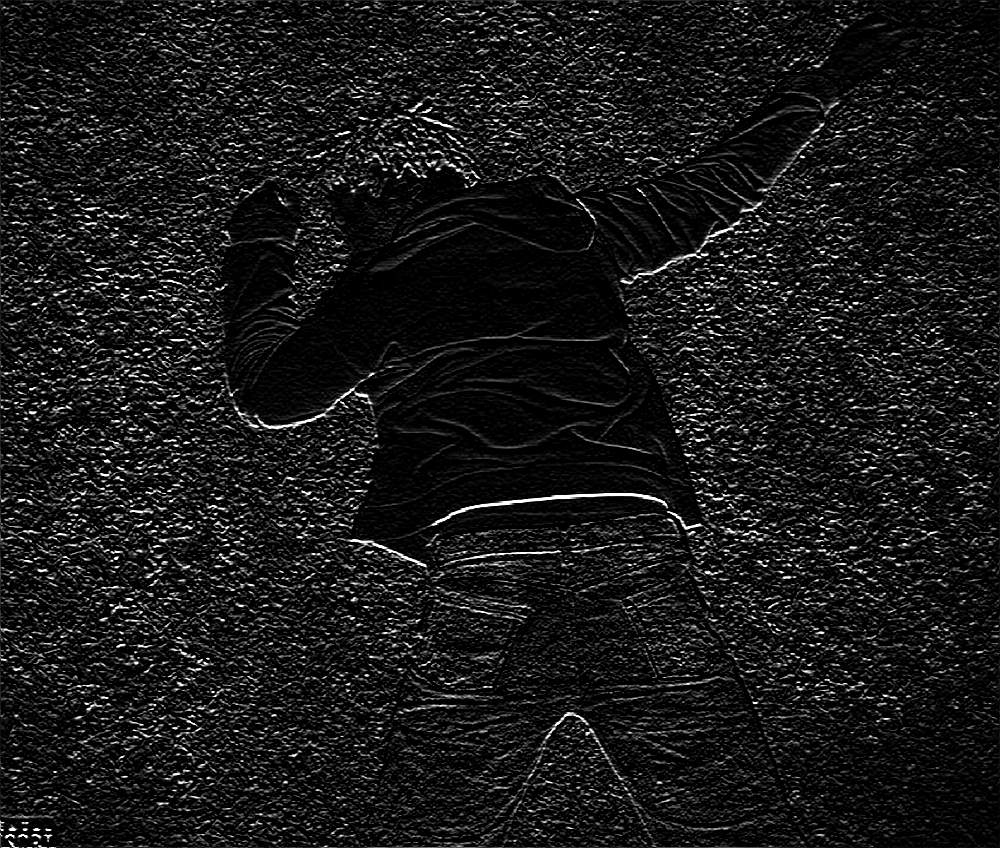

In [9]:
ImageFilter.EMBOSS.filterargs = ((3, 3), 1, 0,  (-1, -2, -1, 0, 0, 0, 1, 2, 1)) # zmiana argumentów
zad3_a_2_image = image_L_mode.filter(ImageFilter.EMBOSS) 
zad3_a_2_image

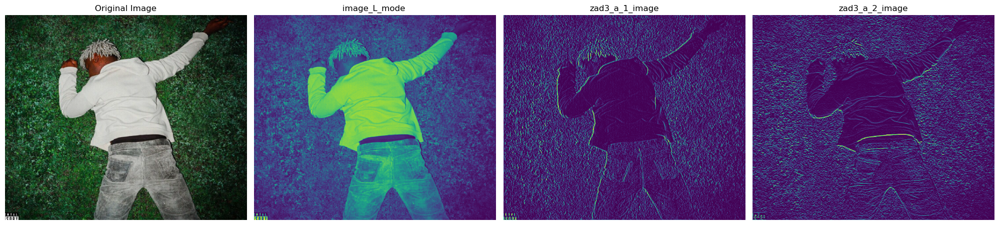

In [10]:
fig, axes = plt.subplots(1, 4, figsize=(20, 5))
axes[0].imshow(original_image)
axes[0].set_title("Original Image")
axes[0].axis("off")

axes[1].imshow(image_L_mode)
axes[1].set_title("image_L_mode ")
axes[1].axis("off")

axes[2].imshow(zad3_a_1_image)
axes[2].set_title("zad3_a_1_image")
axes[2].axis("off")

axes[3].imshow(zad3_a_2_image)
axes[3].set_title("zad3_a_2_image")
axes[3].axis("off")

plt.tight_layout()
plt.savefig("fig2.png")
plt.show()

# Zadanie 4

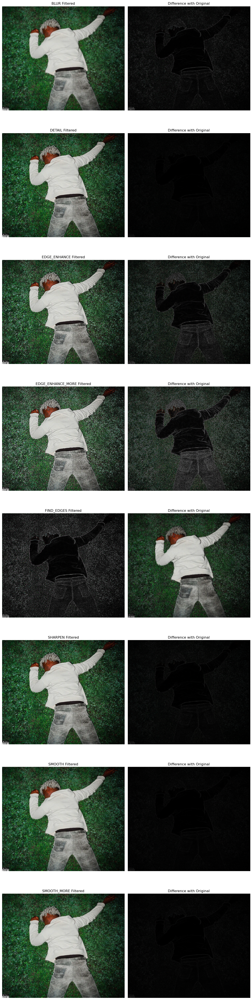

In [11]:
filters = [
    ("BLUR", ImageFilter.BLUR),
    ("DETAIL", ImageFilter.DETAIL),
    ("EDGE_ENHANCE", ImageFilter.EDGE_ENHANCE),
    ("EDGE_ENHANCE_MORE", ImageFilter.EDGE_ENHANCE_MORE),
    ("FIND_EDGES", ImageFilter.FIND_EDGES),
    ("SHARPEN", ImageFilter.SHARPEN),
    ("SMOOTH", ImageFilter.SMOOTH),
    ("SMOOTH_MORE", ImageFilter.SMOOTH_MORE),
]

fig, axes = plt.subplots(len(filters), 2, figsize=(12, len(filters) * 6))

for i, (filter_name, filter_obj) in enumerate(filters):
    filtered_image = original_image.filter(filter_obj)
    
    diff_image = Image.fromarray(
        np.abs(
            np.array(original_image, dtype=np.int32) - np.array(filtered_image, dtype=np.int32)
        ).clip(0, 255).astype(np.uint8)
    )
    
    axes[i, 0].imshow(filtered_image)
    axes[i, 0].set_title(f"{filter_name} Filtered")
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(diff_image)
    axes[i, 1].set_title(f"Difference with Original")
    axes[i, 1].axis('off')

plt.tight_layout()
output_path = "fig3.png"
plt.savefig(output_path)
plt.show()


# Zadanie 5

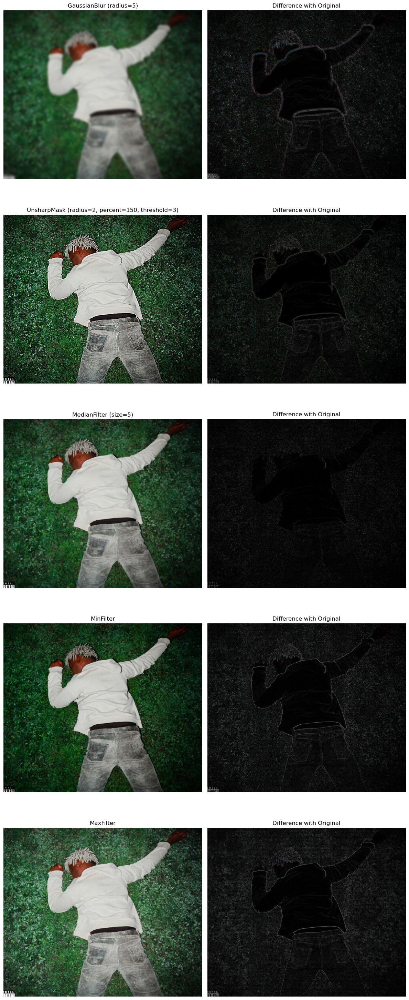

In [12]:
custom_filters = [
    ("GaussianBlur (radius=5)", ImageFilter.GaussianBlur(radius=5)),
    ("UnsharpMask (radius=2, percent=150, threshold=3)", ImageFilter.UnsharpMask(radius=2, percent=150, threshold=3)),
    ("MedianFilter (size=5)", ImageFilter.MedianFilter(size=5)),
    ("MinFilter", ImageFilter.MinFilter()),
    ("MaxFilter", ImageFilter.MaxFilter()),
]

fig, axes = plt.subplots(len(custom_filters), 2, figsize=(12, len(custom_filters) * 6))

for i, (filter_name, filter_obj) in enumerate(custom_filters):
    filtered_image = original_image.filter(filter_obj)
    
    diff_image = Image.fromarray(
        np.abs(
            np.array(original_image, dtype=np.int32) - np.array(filtered_image, dtype=np.int32)
        ).clip(0, 255).astype(np.uint8)
    )
    
    axes[i, 0].imshow(filtered_image)
    axes[i, 0].set_title(f"{filter_name}")
    axes[i, 0].axis('off')
    
    axes[i, 1].imshow(diff_image)
    axes[i, 1].set_title("Difference with Original")
    axes[i, 1].axis('off')

plt.tight_layout()
output_path_fig4 = "fig4.png"
plt.savefig(output_path_fig4)
plt.show()
